In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import base64
import imageio
import IPython
import matplotlib
import matplotlib.pyplot as plt
import PIL.Image
import pyvirtualdisplay
import numpy as np
from tqdm import tqdm
import cv2
import os
import gym
import tensorflow as tf
tf.compat.v1.enable_v2_behavior()

from tf_agents.agents.ddpg import critic_network
from tf_agents.agents.sac import sac_agent
from tf_agents.drivers import dynamic_step_driver
from tf_agents.environments import suite_gym
from tf_agents.environments import tf_py_environment
from tf_agents.eval import metric_utils
from tf_agents.metrics import tf_metrics
from tf_agents.networks import actor_distribution_network
from tf_agents.networks import normal_projection_network
from tf_agents.policies import greedy_policy
from tf_agents.policies import random_tf_policy
from tf_agents.replay_buffers import tf_uniform_replay_buffer
from tf_agents.trajectories import trajectory
from tf_agents.utils import common
import tf_agents

import custom_critic_network

In [2]:
display = pyvirtualdisplay.Display(visible=0, size=(1400, 900)).start()

In [3]:
print(tf.__version__)

2.2.0


In [14]:
horizon=1000
def create_env():   
    return suite_gym.load(
            'CarRacing-v0',
            max_episode_steps=horizon,
            gym_env_wrappers=(ObsNormalizer,)
        ) 

In [13]:
SCALE       = 6.0        # Track scale
PLAYFIELD   = 2000/SCALE # Game over boundary
FPS         = 50         # Frames per second

class ObsNormalizer(gym.ObservationWrapper):

    def __init__(self, env):
        super(ObsNormalizer, self).__init__(env)
        self.observation_space = gym.spaces.Box(
            0.0, 1.0, [96, 96, 3], dtype=np.float32
        )
        self.env.verbose = 0

    def observation(self, obs):
        return obs/255.0

In [23]:
SCALE       = 6.0        # Track scale
PLAYFIELD   = 2000/SCALE # Game over boundary
FPS         = 50         # Frames per second

class RewardRoute(gym.Wrapper):

    def __init__(self, env):
        super(RewardRoute, self).__init__(env)
        self.observation_space = gym.spaces.Box(
            0.0, 1.0, [96, 96, 3], dtype=np.float32
        )
        print('ini')
        self.env.verbose = 0
        self.count_outside = 0

    def observation(self, obs):
        return obs/255.0 
    
    def on_segment(self, p, q, r):
        if((q[0] <= max(p[0], r[0])) and (q[0] >= min(p[0], r[0])) and (q[1] <= max(p[1], r[1])) and (q[1] >= min(p[1], r[1]))):
            return True
        else:
            return False

    def orientation(self, p, q, r):
        val = ((q[1] - p[1]) * (r[0] - q[0])) - ((q[0] - p[0]) * (r[1] - q[1]))

        if(val == 0):
            return 0 #colinear
        elif(val > 0):
            return 1 #clockwise
        else:
            return 2 #counterclockwise


    def intersection(self, p1, q1, p2, q2):
        o1 = self.orientation(p1, q1, p2)
        o2 = self.orientation(p1, q1, q2)
        o3 = self.orientation(p2, q2, p1)
        o4 = self.orientation(p2, q2, q1)

        if(o1 != o2 and o3 != o4): 
            return True

        #// Special Cases 
        #// p1, q1 and p2 are colinear and p2 lies on segment p1q1 
        if(o1 == 0 and self.on_segment(p1, p2, q1)):
            return True 

        #// p1, q1 and p2 are colinear and q2 lies on segment p1q1 
        if(o2 == 0 and self.on_segment(p1, q2, q1)):
            return True 

        #// p2, q2 and p1 are colinear and p1 lies on segment p2q2 
        if(o3 == 0 and self.on_segment(p2, p1, q2)):
            return True 

        #// p2, q2 and q1 are colinear and q1 lies on segment p2q2 
        if(o4 == 0 and self.on_segment(p2, q1, q2)):
            return True 

        return False# // Doesn't fall in any of the above cases 


    def is_inside_polygon(self, p_car, points):
        assert (len(points) == 4), 'Polygon must have 4 vertices'

        #// Create a point for line segment from p to infinite 
        extreme = (2000, p_car[1]) 

        intersections = []
        intersections.append(self.intersection(points[0], points[1], p_car, extreme))
        intersections.append(self.intersection(points[1], points[2], p_car, extreme))
        intersections.append(self.intersection(points[2], points[3], p_car, extreme))
        intersections.append(self.intersection(points[3], points[0], p_car, extreme))

        return sum(intersections)%2

    def is_outside_road(self, p_car):
        for i, item in enumerate(self.road_poly):
            polygon = item[0]
            if(self.is_inside_polygon(p_car, polygon)):
                #print('inside:', i)
                return False
        return True
    
    def reset(self):
        print('Reset')
        self.count_outside = 0
        self.env.reset()
        
    def step(self, action):
        #print('h')
        state, step_reward, done, _ = self.env.step(action)
        x, y = self.env.car.hull.position
        if(self.is_outside_road((x,y))):
            #done = True
            #self.env.reward -= 1
            #step_reward -= 1
            self.count_outside += 1
            print(self.count_outside, step_reward)
        else:
            self.count_outside = 0
            
        if(self.count_outside == 200):
            done = True

        return state, step_reward, done, {}

## Testing  

#### Auxiliary functions

In [3]:
def compute_avg_return(environment, policy, num_episodes=10):

    total_return = 0.0
    for _ in tqdm(range(num_episodes)):
        time_step = environment.reset()
        episode_return = 0.0

        while not time_step.is_last():
            action_step = policy.action(time_step)
            time_step = environment.step(action_step.action)
            episode_return += time_step.reward
        
        total_return += episode_return

    avg_return = total_return / num_episodes
    return avg_return.numpy()[0]

In [4]:
def embed_mp4(filename):
    """Embeds an mp4 file in the notebook."""
    video = open(filename,'rb').read()
    b64 = base64.b64encode(video)
    tag = '''
    <video width="640" height="480" controls>
    <source src="data:video/mp4;base64,{0}" type="video/mp4">
    Your browser does not support the video tag.
    </video>'''.format(b64.decode())

    return IPython.display.HTML(tag)

In [5]:
def create_policy_eval_video(policy, filename, eval_py_env, eval_env, num_episodes=5, fps=30):
    filename = filename + ".mp4"
    with imageio.get_writer(filename, fps=fps) as video:
        for _ in range(num_episodes):
            time_step = eval_env.reset()
            video.append_data(eval_py_env.render())
            while not time_step.is_last():
                action_step = policy.action(time_step)
                time_step = eval_env.step(action_step.action)
                video.append_data(eval_py_env.render())
    return embed_mp4(filename)

In [8]:
def create_env():
    return suite_gym.load('CarRacing-v0', max_episode_steps=1000, gym_env_wrappers=(wp.RescaleAction, wp.MultInput,))

In [9]:
eval_py_env = create_env()
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

action wrapper
MultInput


In [10]:
print('obs:',eval_env.observation_spec())
print('action:', eval_env.action_spec())

obs: OrderedDict([('image', BoundedTensorSpec(shape=(96, 96, 3), dtype=tf.uint8, name='observation/image', minimum=array(0, dtype=uint8), maximum=array(255, dtype=uint8))), ('measurements', BoundedTensorSpec(shape=(3,), dtype=tf.float32, name='observation/measurements', minimum=array([ 0., -1., -1.], dtype=float32), maximum=array([200.,   1.,   1.], dtype=float32)))])
action: BoundedTensorSpec(shape=(2,), dtype=tf.float32, name='action', minimum=array(-1., dtype=float32), maximum=array(1., dtype=float32))


In [3]:
from SAC import SAC

sac_RE_10 = SAC('CarRacing-v0', horizon=1000, batch_size=10, buffer_size=50,
               initial_collect_steps=30, critic_lr=3e-4, actor_lr=3e-4, alpha_lr=3e-4, target_update_tau=0.005, log_dir='sac_11',
               target_update_period=1, gamma=0.99, actor_fc_layer_params=(256,256), critic_joint_fc_layer_params=(256,256),
               summary_interval=100, summaries_flush_secs=1, reward_scale=10.0, num_eval_episodes=1, 
               gradient_clipping=None, collect_steps_per_iteration=1, resume_training=False)

sac_RE_10.learn(num_iterations=1000)

/home/cfcv/Desktop/gym/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


render_wrapper
Gray ObsNormalizer
StartSkip wrapper
action wrapper
MultInput_waypointImg
render_wrapper
Gray ObsNormalizer
StartSkip wrapper
action wrapper
MultInput_waypointImg
obs: OrderedDict([('image', BoundedTensorSpec(shape=(84, 84, 2), dtype=tf.float32, name='observation/image', minimum=array(0., dtype=float32), maximum=array(1., dtype=float32))), ('measurements', BoundedTensorSpec(shape=(3,), dtype=tf.float32, name='observation/measurements', minimum=array([ 0., -1., -1.], dtype=float32), maximum=array(1., dtype=float32)))])
action: BoundedTensorSpec(shape=(2,), dtype=tf.float32, name='action', minimum=array(-1., dtype=float32), maximum=array(1., dtype=float32))
Instructions for updating:
`AffineScalar` bijector is deprecated; please use `tfb.Shift(loc)(tfb.Scale(...))` instead.
------- Filling Buffer -------
Track generation: 1177..1475 -> 298-tiles track
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf

  5%|▍         | 49/1000 [00:07<02:20,  6.77it/s] 


KeyboardInterrupt: 

In [6]:
input_1 = tf.keras.layers.Input(shape=(84,84,1))
input_2 = tf.keras.layers.Input(shape=(3))

c1 = tf.keras.layers.Conv2D(32, 8, strides=4, activation='relu', kernel_initializer=tf.keras.initializers.Orthogonal(np.sqrt(2)))(input_1)
c2 = tf.keras.layers.Conv2D(64, 4, strides=2, activation='relu', kernel_initializer=tf.keras.initializers.Orthogonal(np.sqrt(2)))(c1)
c3 = tf.keras.layers.Conv2D(64, 3, strides=1, activation='relu', kernel_initializer=tf.keras.initializers.Orthogonal(np.sqrt(2)))(c2)
f = tf.keras.layers.Flatten()(c3)
d_c = tf.keras.layers.Dense(512, activation='relu', kernel_initializer=tf.keras.initializers.Orthogonal(np.sqrt(2)))(f)


d1 = tf.keras.layers.Dense(128, activation='relu')(input_2)
d2 = tf.keras.layers.Dense(64, activation='relu')(d1)

concat = tf.keras.layers.Concatenate(axis=-1)([d_c, d2])

merge_d = tf.keras.layers.Dense(128, activation='relu')(concat)

out = tf.keras.layers.Dense(2, activation='tanh')(merge_d)
        
model = tf.keras.Model(inputs=[input_1, input_2], outputs=out)

In [7]:
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 84, 84, 1)]  0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 20, 20, 32)   2080        input_5[0][0]                    
__________________________________________________________________________________________________
conv2d_7 (Conv2D)               (None, 9, 9, 64)     32832       conv2d_6[0][0]                   
__________________________________________________________________________________________________
conv2d_8 (Conv2D)               (None, 7, 7, 64)     36928       conv2d_7[0][0]                   
____________________________________________________________________________________________

In [4]:
input_1 = tf.keras.layers.Input(shape=(84,84,3))
input_2 = tf.keras.layers.Input(shape=(3))

c1 = tf.keras.layers.Conv2D(32, 8, strides=4, activation='relu', kernel_initializer=tf.keras.initializers.Orthogonal(np.sqrt(2)))(input_1)
c2 = tf.keras.layers.Conv2D(64, 4, strides=2, activation='relu', kernel_initializer=tf.keras.initializers.Orthogonal(np.sqrt(2)))(c1)
c3 = tf.keras.layers.Conv2D(64, 3, strides=1, activation='relu', kernel_initializer=tf.keras.initializers.Orthogonal(np.sqrt(2)))(c2)
f = tf.keras.layers.Flatten()(c3)
d_c = tf.keras.layers.Dense(512, activation='relu', kernel_initializer=tf.keras.initializers.Orthogonal(np.sqrt(2)))(f)


d1 = tf.keras.layers.Dense(128, activation='relu')(input_2)
d2 = tf.keras.layers.Dense(64, activation='relu')(d1)

concat = tf.keras.layers.Concatenate(axis=-1)([d_c, d2])

merge_d = tf.keras.layers.Dense(128, activation='relu')(concat)

out = tf.keras.layers.Dense(2, activation='tanh')(merge_d)
        
model = tf.keras.Model(inputs=[input_1, input_2], outputs=out)

In [5]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 84, 84, 3)]  0                                            
__________________________________________________________________________________________________
conv2d_3 (Conv2D)               (None, 20, 20, 32)   6176        input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_4 (Conv2D)               (None, 9, 9, 64)     32832       conv2d_3[0][0]                   
__________________________________________________________________________________________________
conv2d_5 (Conv2D)               (None, 7, 7, 64)     36928       conv2d_4[0][0]                   
____________________________________________________________________________________________

In [3]:
import os
os.environ["PYOPENGL_PLATFORM"] = "egl"

In [2]:
import wrappers as wp
env = gym.make('CarRacing-v0')

#env = wp.render_wrapper(env)
#env = wp.ObsGrayNormalizer(env)
#env = wp.StartSkip(env)
#env = wp.RescaleAction(env)
env = wp.MultInput(env)
#env = wp.MultInput_waypointImg_R(env)
#env = wp.MultInput_waypointImg(env)

MultInput


/home/cfcv/Desktop/gym/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


In [3]:
import time
state = env.reset()
env.render()

done = False
count = 0
action = [0, 0, 0]
r = 0
images = []

while(count < 1000):
    action = env.action_space.sample()
    if(count == 3):
        time.sleep(2)
    if(count > 0 and count < 80):
        action[0] = 0.0
        action[1] = 0.8
        #action[2] = 0.0

    state, reward, done, info = env.step(action)
    #print(reward)
    r += reward
    images.append(state["measurements"])
    env.render()
    count += 1
    
env.close()
#print(r)

In [4]:
for measurement in images:
    print(measurement[1])

0.999
0.998
0.997
0.996
0.995
0.994
0.993
0.992
0.991
0.99
0.989
0.988
0.987
0.986
0.985
0.984
0.983
0.982
0.981
0.98
0.979
0.978
0.977
0.976
0.975
0.974
0.973
0.972
0.971
0.97
0.969
0.968
0.967
0.966
0.965
0.964
0.963
0.962
0.961
0.96
0.959
0.958
0.957
0.956
0.955
0.954
0.953
0.952
0.951
0.95
0.949
0.948
0.947
0.946
0.945
0.944
0.943
0.942
0.941
0.94
0.939
0.938
0.937
0.936
0.935
0.934
0.933
0.932
0.931
0.93
0.929
0.928
0.927
0.926
0.925
0.924
0.923
0.922
0.921
0.92
0.919
0.918
0.917
0.916
0.915
0.914
0.913
0.912
0.911
0.91
0.909
0.908
0.907
0.906
0.905
0.904
0.903
0.902
0.901
0.9
0.899
0.898
0.897
0.896
0.895
0.894
0.893
0.892
0.891
0.89
0.889
0.888
0.887
0.886
0.885
0.884
0.883
0.882
0.881
0.88
0.879
0.878
0.877
0.876
0.875
0.874
0.873
0.872
0.871
0.87
0.869
0.868
0.867
0.866
0.865
0.864
0.863
0.862
0.861
0.86
0.859
0.858
0.857
0.856
0.855
0.854
0.853
0.852
0.851
0.85
0.849
0.848
0.847
0.846
0.845
0.844
0.843
0.842
0.841
0.84
0.839
0.838
0.837
0.836
0.835
0.834
0.833
0.832
0.831
0.8

Text(0.5, 1.0, '3')

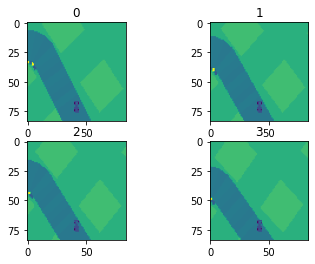

In [38]:
fig, axs = plt.subplots(2, 2)
axs[0, 0].imshow(np.reshape(image[:,:,0], (84,84)))
axs[0, 0].set_title('0')
axs[0, 1].imshow(np.reshape(image[:,:,1], (84,84)))
axs[0, 1].set_title('1')
axs[1, 0].imshow(np.reshape(image[:,:,2], (84,84)))
axs[1, 0].set_title('2')
axs[1, 1].imshow(np.reshape(image[:,:,3], (84,84)))
axs[1, 1].set_title('3')

In [21]:
image = cv2.imread('original.png')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
cv2.imwrite('gray.png', image_gray)
#plt.imshow(image_gray)

True

In [17]:
import cv2
im = cv2.cvtColor(images[280], cv2.COLOR_RGB2BGR)
im = cv2.resize(im, (384,384))
cv2.imwrite('284.jpg', im)

True

In [38]:
env.observation_space.shape[2]

1

In [12]:
len(images)

300

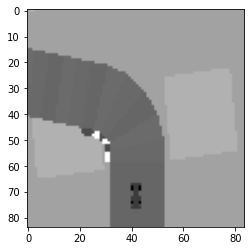

In [33]:
plt.imshow(np.reshape(images[70], (84,84)), cmap='gray')

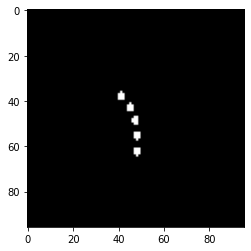

In [32]:
plt.imshow(traj[70])

In [11]:
traj[75].shape

(96, 96, 3)

In [69]:
traj_cut = traj[75][:84,6:-6,:]
traj_gray = cv2.cvtColor(traj_cut, cv2.COLOR_RGB2GRAY)
traj_gauss = cv2.GaussianBlur(traj_gray, (7,7), sigmaX=0.8)
traj_final = traj_gauss/255.0

In [70]:
traj_final.shape

(84, 84)

In [72]:
state = np.stack([images[75][:,:,0], traj_final], axis=2)

In [7]:
images[50]

AttributeError: 'dict' object has no attribute 'shape'

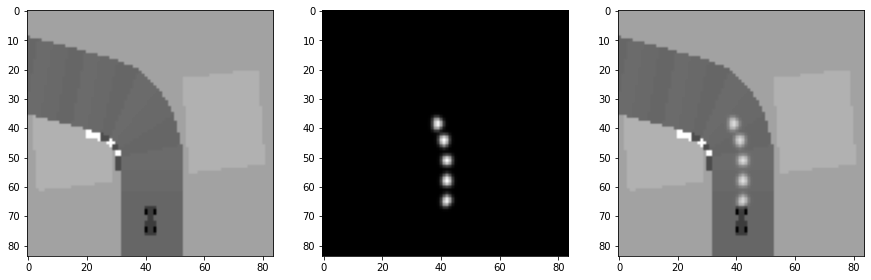

In [4]:
fig = plt.figure(figsize=(15, 10)) 
ax = fig.add_subplot(1,3,1)
ax.imshow(images[70][:,:,0], cmap='gray')

ax = fig.add_subplot(1,3,2)
ax.imshow(images[70][:,:,1], cmap='gray')

ax = fig.add_subplot(1,3,3)
ax.imshow(cv2.addWeighted(images[70][:,:,0], 1.0, images[70][:,:,1], 0.5, 0.0), cmap='gray')

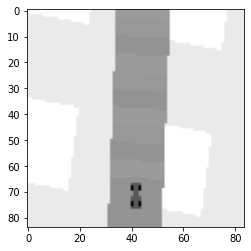

In [9]:
plt.imshow(np.reshape(images[0], (84,84)), cmap='gray')

### No waypoints 

In [16]:
import wrappers as wp

horizon=1000
def create_env():   
    return suite_gym.load(
            'CarRacing-v0',
            max_episode_steps=horizon,
            gym_env_wrappers=(wp.ObsGrayNormalizer, wp.StartSkip, wp.RescaleAction_clip, wp.MultInput_waypointVec,)
        
        )

In [17]:
eval_py_env = create_env()
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

Gray ObsNormalizer
StartSkip wrapper
action wrapper
MultInput_waypointVec


In [11]:
imgR25_policy = tf.compat.v2.saved_model.load("/home/cfcv/Desktop/seed_log/odometrie_clip_alpha_imgR25/odometrie_clip_alpha_img_R25_2/best_policy")

In [18]:
vecR25_policy = tf.compat.v2.saved_model.load("/home/cfcv/Desktop/seed_log/odometrie_clip_alpha_vecR25/odometrie_clip_alpha_vec_R25_3/best_policy")

In [12]:
create_policy_eval_video(imgR25_policy, 'img_r25', eval_py_env, eval_env, num_episodes=10, fps=30)

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (600, 400) to (608, 400) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


In [19]:
create_policy_eval_video(vecR25_policy, 'vec_r25', eval_py_env, eval_env, num_episodes=10, fps=30)

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (600, 400) to (608, 400) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


#### Rdist steer velocity 

In [13]:
NO__Rdist_sv_policy = tf.compat.v2.saved_model.load('/home/cfcv/Desktop/waypoints/NO/NO_alpha_lr1_Rdist_steer_velocity/policy')
NO__Rdist_sv_best_policy = tf.compat.v2.saved_model.load('/home/cfcv/Desktop/waypoints/NO/NO_alpha_lr1_Rdist_steer_velocity/best_policy')

In [9]:
mean = compute_avg_return(eval_env, NO__Rdist_sv_policy, num_episodes=100)
print('Average Reward: ', mean)

100%|██████████| 100/100 [15:40<00:00,  9.40s/it]

Average Reward:  678.88776


In [9]:
mean = compute_avg_return(eval_env, NO__Rdist_sv_best_policy, num_episodes=100)
print('Average Reward: ', mean)

100%|██████████| 100/100 [17:47<00:00, 10.68s/it]

Average Reward:  845.22314


In [14]:
create_policy_eval_video(NO__Rdist_sv_policy, 'NO_Rdist_sv_policy', eval_py_env, eval_env, num_episodes=3, fps=30)

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (600, 400) to (608, 400) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


In [15]:
create_policy_eval_video(NO__Rdist_sv_best_policy, 'NO_Rdist_sv_best_policy', eval_py_env, eval_env, num_episodes=3, fps=30)

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (600, 400) to (608, 400) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


#### Rdist25 steer velocity 

In [8]:
NO_Rdist25_sv_policy = tf.compat.v2.saved_model.load('/home/cfcv/Desktop/waypoints/NO/NO_alpha_lr1_Rdist25_steer_velocity/policy')
NO_Rdist25_sv_best_policy = tf.compat.v2.saved_model.load('/home/cfcv/Desktop/waypoints/NO/NO_alpha_lr1_Rdist25_steer_velocity/best_policy')

In [9]:
mean = compute_avg_return(eval_env, NO_Rdist25_sv_policy, num_episodes=100)
print('Average Reward: ', mean)

100%|██████████| 100/100 [18:19<00:00, 11.00s/it]

Average Reward:  572.76013


In [10]:
mean = compute_avg_return(eval_env, NO_Rdist25_sv_best_policy, num_episodes=100)
print('Average Reward: ', mean)

100%|██████████| 100/100 [18:39<00:00, 11.20s/it]

Average Reward:  756.9275


In [11]:
create_policy_eval_video(NO_Rdist25_sv_policy, 'NO_Rdist25_sv_policy', eval_py_env, eval_env, num_episodes=3, fps=30)

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (600, 400) to (608, 400) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


In [12]:
create_policy_eval_video(NO_Rdist25_sv_best_policy, 'NO_Rdist25_sv_best_policy', eval_py_env, eval_env, num_episodes=3, fps=30)

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (600, 400) to (608, 400) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


### Image waypoints

In [3]:
import wrappers as wp

horizon=1000
def create_env():   
    return suite_gym.load(
            'CarRacing-v0',
            max_episode_steps=horizon,
            gym_env_wrappers=(wp.render_wrapper, wp.ObsGrayNormalizer, wp.StartSkip, wp.RescaleAction, wp.MultInput_waypointImg,)
        
        )

In [4]:
eval_py_env = create_env()
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

render_wrapper
Gray ObsNormalizer
StartSkip wrapper
action wrapper
MultInput_waypointImg


/home/cfcv/Desktop/gym/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


#### lr1 Rdist 25 65 steer velocity close 

In [21]:
time_step = eval_env.reset()

count = 0
steer_list = []
throtlle_list = []
while(not time_step.is_last()):
    action_step = combine_ad_lr1_2M_best_policy.action(time_step)
    time_step = eval_env.step(action_step.action)
    
    measurements = time_step.observation['measurements'].numpy()[0]
    steer_list.append(measurements[1])
    throtlle_list.append(measurements[2])


(array([ 28.,  28.,  38.,  39.,  22.,  41.,  55.,  90., 159., 500.]),
 array([-0.97845274, -0.78095317, -0.5834536 , -0.38595402, -0.18845445,
         0.00904512,  0.2065447 ,  0.40404427,  0.60154384,  0.7990434 ,
         0.996543  ], dtype=float32),
 <a list of 10 Patch objects>)

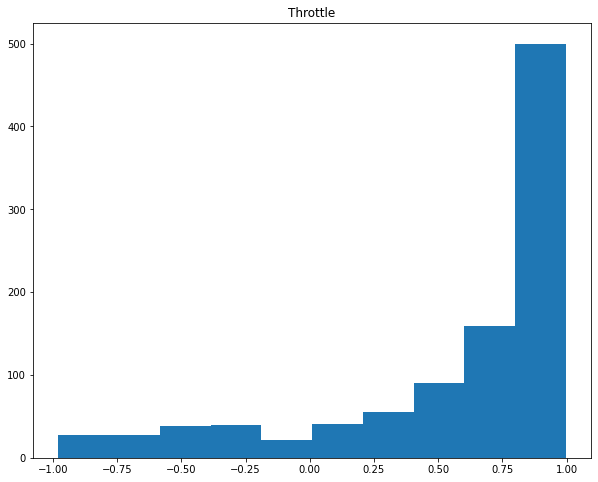

In [24]:
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(1,1,1)
ax.set_title("Throttle")
ax.hist(throtlle_list)

In [12]:
print(len(steer_list))

1000


In [13]:
print(len(throtlle_list))

1000


In [26]:
before_steer = steer_list
before_throttle = throtlle_list

(array([135.,  12.,  21.,  32.,  30.,  63.,  52.,  85., 183., 387.]),
 array([-0.3       , -0.17034571, -0.04069141,  0.08896289,  0.21861719,
         0.3482715 ,  0.47792578,  0.60758007,  0.7372344 ,  0.8668887 ,
         0.996543  ], dtype=float32),
 <a list of 10 Patch objects>)

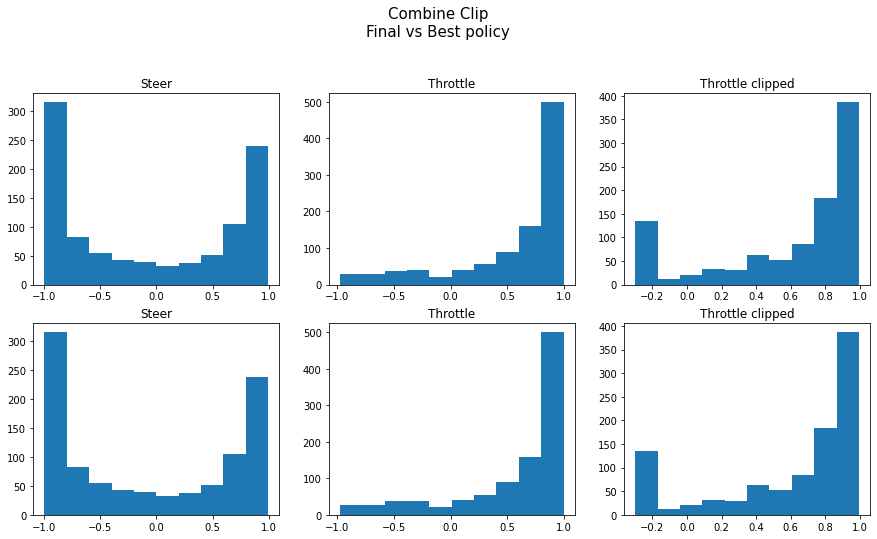

In [27]:
fig = plt.figure(figsize=(15,12))
fig.suptitle('Combine Clip\nFinal vs Best policy\n', fontsize=15)

ax1 = fig.add_subplot(3,3,1)
ax1.set_title("Steer")
ax1.hist(before_steer)

ax2 = fig.add_subplot(3,3,2)
ax2.set_title("Throttle")
ax2.hist(before_throttle)

ax3 = fig.add_subplot(3,3,3)
ax3.set_title("Throttle clipped")
ax3.hist(np.clip(before_throttle, -0.3, 1.0))

ax4 = fig.add_subplot(3,3,4)
ax4.set_title("Steer")
ax4.hist(steer_list)

ax5 = fig.add_subplot(3,3,5)
ax5.set_title("Throttle")
ax5.hist(throtlle_list)

ax6 = fig.add_subplot(3,3,6)
ax6.set_title("Throttle clipped")
ax6.hist(np.clip(throtlle_list, -0.3, 1.0))

#ax1 = fig.add_subplot(3,3,3)
#ax1.set_title("Throttle clip")
#ax1.hist(np.clip(throtlle_list, -0.3, 1.0))
#a = a.ravel()

#ax = a[0]
#a[0].hist(steer_list)

#a[1].hist(throtlle_list)

#a[2].hist(np.clip(throtlle_list, -0.3, 1.0))

In [26]:
a

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f14283d6be0>,
      dtype=object)

In [ ]:
f,a = plt.subplots(1,3)
a = a.ravel()
for idx,ax in enumerate(a):
    ax.hist(data[idx])
    ax.set_title(titles[idx])
    ax.set_xlabel(xaxes[idx])
    ax.set_ylabel(yaxes[idx])
plt.tight_layout()

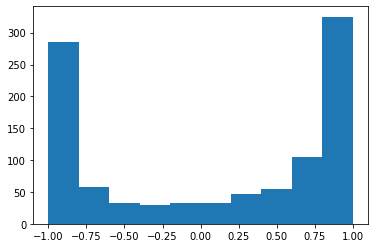

In [21]:
plt.hist(steer_list)
plt.show()

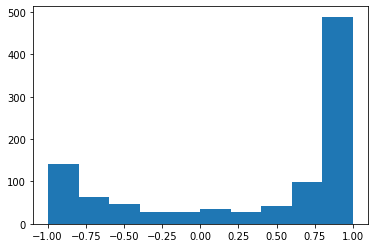

In [22]:
plt.hist(throtlle_list)
plt.show()

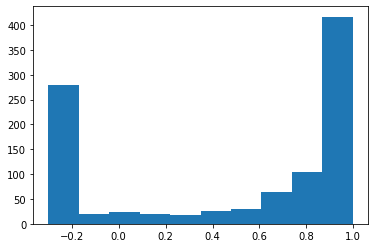

In [23]:
plt.hist(np.clip(throtlle_list, -0.3, 1.0))
plt.show()

In [31]:
measurements = time_step.observation['measurements'].numpy()[0]
print(measurements)

[0.04382161 0.9830735  0.99214894]


In [4]:
categorical_policy = tf.compat.v2.saved_model.load('/media/cfcv/Daniel Alencar/RL/logs_server/experience8/categorical/policy')
categorical_best_policy = tf.compat.v2.saved_model.load('/media/cfcv/Daniel Alencar/RL/logs_server/experience8/categorical/best_policy')

In [10]:
mean = compute_avg_return(eval_env, categorical_policy, num_episodes=100)
print('Average Reward: ', mean)

100%|██████████| 100/100 [16:42<00:00, 10.03s/it]

Average Reward:  66.934265


In [11]:
mean = compute_avg_return(eval_env, categorical_best_policy, num_episodes=100)
print('Average Reward: ', mean)

100%|██████████| 100/100 [17:12<00:00, 10.33s/it]

Average Reward:  468.442
